In [1]:
%%time
import matplotlib.pyplot as plt
import xarray as xr

CPU times: user 2.37 s, sys: 68.9 ms, total: 2.44 s
Wall time: 544 ms


---
## Sentinel-1 GRD

In [2]:
%%time
path = (
    "https://objectstore.eodc.eu:2222/e05ab01a9d56408d82ac32d69a5aae2a:sample-data/tutorial_data/"
    "cpm_v253/S1A_IW_GRDH_1SDV_20240201T164915_20240201T164940_052368_065517_750E.zarr"
)

CPU times: user 2 μs, sys: 0 ns, total: 2 μs
Wall time: 4.29 μs


In [3]:
%%time
dt = xr.open_datatree(path, engine="eopf-zarr")
dt

CPU times: user 286 ms, sys: 34.8 ms, total: 320 ms
Wall time: 12.4 s


<xarray.DataTree>
Group: /
│   Attributes:
│       other_metadata:  {'azimuth_steering_rate': 0.0, 'eopf_category': 'eoconta...
│       stac_discovery:  {'assets': {}, 'bbox': [18.626646, 39.456726, 15.211703,...
├── Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH
│   │   Attributes:
│   │       other_metadata:  {'azimuth_steering_rate': 0.0, 'downlink_information': {...
│   │       stac_discovery:  {'assets': {}, 'bbox': [18.626646, 39.456726, 15.211703,...
│   ├── Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH/conditions
│   │   ├── Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH/conditions/antenna_pattern
│   │   │       Dimensions:           (azimuth_time: 27, slant_range_time: 720)
│   │   │       Coordinates:
│   │   │         * azimuth_time      (azimuth_time) datetime64[ns] 216B 2024-02-01T16:49:15....
│   │   │           slant_range_time  (azimuth_time, slant_range_time) float32 78kB ...
│   │   │       Data variables:
│   │   │           elevation_angle   (azimuth_time, slant_range_time) float32 78kB ...
│   │   │           incidence_angle   (azimuth_time, slant_range_time) float32 78kB ...
│   │   │           roll              (azimuth_time) float32 108B ...
│   │   │           terrain_height    (azimuth_time) float32 108B ...
│   │   ├── Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH/conditions/attitude
│   │   │       Dimensions:       (azimuth_time: 25)
│   │   │       Coordinates:
│   │   │         * azimuth_time  (azimuth_time) datetime64[ns] 200B 2024-02-01T16:49:15.8750...
│   │   │       Data variables:
│   │   │           pitch         (azimuth_time) float32 100B ...
│   │   │           q0            (azimuth_time) float32 100B ...
│   │   │           q1            (azimuth_time) float32 100B ...
│   │   │           q2            (azimuth_time) float32 100B ...
│   │   │           q3            (azimuth_time) float32 100B ...
│   │   │           roll          (azimuth_time) float32 100B ...
│   │   │           wx            (azimuth_time) float32 100B ...
│   │   │           wy            (azimuth_time) float32 100B ...
│   │   │           wz            (azimuth_time) float32 100B ...
│   │   │           yaw           (azimuth_time) float32 100B ...
│   │   ├── Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH/conditions/azimuth_fm_rate
│   │   │       Dimensions:                     (azimuth_time: 10, degree: 3)
│   │   │       Coordinates:
│   │   │         * azimuth_time                (azimuth_time) datetime64[ns] 80B 2024-02-01T...
│   │   │       Dimensions without coordinates: degree
│   │   │       Data variables:
│   │   │           azimuth_fm_rate_polynomial  (azimuth_time, degree) float32 120B ...
│   │   │           t0                          (azimuth_time) float32 40B ...
│   │   ├── Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH/conditions/coordinate_conversion
│   │   │       Dimensions:            (azimuth_time: 28, degree: 9)
│   │   │       Coordinates:
│   │   │         * azimuth_time       (azimuth_time) datetime64[ns] 224B 2024-02-01T16:49:13...
│   │   │       Dimensions without coordinates: degree
│   │   │       Data variables:
│   │   │           gr0                (azimuth_time) float32 112B ...
│   │   │           grsr_coefficients  (azimuth_time, degree) float32 1kB ...
│   │   │           slant_range_time   (azimuth_time) float32 112B ...
│   │   │           sr0                (azimuth_time) float32 112B ...
│   │   │           srgr_coefficients  (azimuth_time, degree) float32 1kB ...
│   │   ├── Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH/conditions/doppler_centroid
│   │   │       Dimensions:                            (azimuth_time: 27, degree: 3)
│   │   │       Coordinates:
│   │   │         * azimuth_time                       (azimuth_time) datetime64[ns] 216B 202...
│   │   │       Dimensions without coordinates: degree
│   │   │       Data variables:
│   │   │           data_dc_polynomial

In [4]:
%%time
ds = dt.S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH.measurements
ds

CPU times: user 214 μs, sys: 13 μs, total: 227 μs
Wall time: 232 μs


<xarray.DataTree 'measurements'>
Group: /S01SIWGRD_20240201T164915_0025_A299_750E_065517_VH/measurements
    Dimensions:       (azimuth_time: 16675, ground_range: 26456)
    Coordinates:
      * azimuth_time  (azimuth_time) datetime64[ns] 133kB 2024-02-01T16:49:15.722...
    Dimensions without coordinates: ground_range
    Data variables:
        grd           (azimuth_time, ground_range) uint16 882MB ...

CPU times: user 3.95 s, sys: 2.46 s, total: 6.41 s
Wall time: 29 s


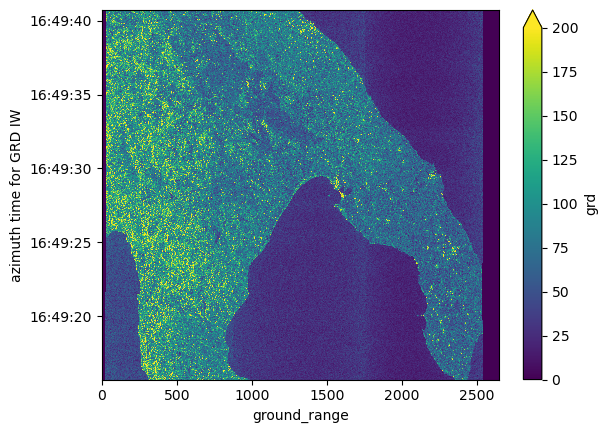

In [5]:
%%time
ds.grd[::10, ::10].plot(vmax=200)

----
## Sentinel-1 SLC

In [6]:
%%time
path = (
    "https://objectstore.eodc.eu:2222/e05ab01a9d56408d82ac32d69a5aae2a:sample-data/tutorial_data/"
    "cpm_v253/S1A_IW_SLC__1SDV_20231119T170635_20231119T170702_051289_063021_178F.zarr"
)

CPU times: user 2 μs, sys: 1e+03 ns, total: 3 μs
Wall time: 4.53 μs


In [7]:
%%time
dt = xr.open_datatree(path, engine="eopf-zarr", chunks={})
dt

CPU times: user 6.74 s, sys: 388 ms, total: 7.13 s
Wall time: 1min 16s


<xarray.DataTree>
Group: /
│   Attributes:
│       other_metadata:  {'azimuth_steering_rate': 0.0, 'eopf_category': 'eoconta...
│       stac_discovery:  {'assets': {}, 'bbox': [13.826541, 42.38739, 10.28547, 4...
├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411
│   │   Attributes:
│   │       other_metadata:  {'azimuth_steering_rate': 0.0, 'downlink_information': {...
│   │       stac_discovery:  {'assets': {}, 'bbox': [13.826541, 42.38739, 10.28547, 4...
│   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/antenna_pattern
│   │   │       Dimensions:           (azimuth_time: 10, slant_range_time: 712)
│   │   │       Coordinates:
│   │   │         * azimuth_time      (azimuth_time) datetime64[ns] 80B 2023-11-19T17:06:36.1...
│   │   │         * slant_range_time  (slant_range_time) float32 3kB 0.005336 ... 0.00569
│   │   │       Data variables:
│   │   │           elevation_angle   (azimuth_time, slant_range_time) float32 28kB dask.array<chunksize=(10, 712), meta=np.ndarray>
│   │   │           incidence_angle   (azimuth_time, slant_range_time) float32 28kB dask.array<chunksize=(10, 712), meta=np.ndarray>
│   │   │           roll              (azimuth_time) float32 40B dask.array<chunksize=(10,), meta=np.ndarray>
│   │   │           terrain_height    (azimuth_time) float32 40B dask.array<chunksize=(10,), meta=np.ndarray>
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/attitude
│   │   │       Dimensions:       (azimuth_time: 25)
│   │   │       Coordinates:
│   │   │         * azimuth_time  (azimuth_time) datetime64[ns] 200B 2023-11-19T17:06:36.8749...
│   │   │       Data variables:
│   │   │           pitch         (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q0            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q1            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q2            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q3            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           roll          (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           wx            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           wy            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           wz            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           yaw           (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/azimuth_fm_rate
│   │   │       Dimensions:                     (azimuth_time: 10, degree: 3)
│   │   │       Coordinates:
│   │   │         * azimuth_time                (azimuth_time) datetime64[ns] 80B 2023-11-19T...
│   │   │       Dimensions without coordinates: degree
│   │   │       Data variables:
│   │   │           azimuth_fm_rate_polynomial  (azimuth_time, degree) float32 120B dask.array<chunksize=(10, 3), meta=np.ndarray>
│   │   │           t0                          (azimuth_time) float32 40B dask.array<chunksize=(10,), meta=np.ndarray>
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/doppler_centroid
│   │   │       Dimensions:                            (azimuth_time: 10, degree: 3)
│   │   │       Coordinates:
│   │   │         * azimuth_time                       (azimuth_time) datetime64[ns] 80B 2023...
│   │   │       Dimensions without coordinates: degree
│   │   │       Data variables:
│   │   │           data_dc_polynomial                 (azimu

In [8]:
dt.groups

('/',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249412',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249413',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249414',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249415',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249416',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249417',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249418',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249419',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW2_249411',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW2_249412',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW2_249413',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW2_249414',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW2_249415',
 '/S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW

In [9]:
%%time
ds = dt.S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411.measurements
ds

CPU times: user 180 μs, sys: 34 μs, total: 214 μs
Wall time: 217 μs


<xarray.DataTree 'measurements'>
Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/measurements
    Dimensions:       (azimuth_time: 1501, slant_range_time: 22694)
    Coordinates:
      * azimuth_time  (azimuth_time) datetime64[ns] 12kB 2023-11-19T17:06:36.1679...
    Dimensions without coordinates: slant_range_time
    Data variables:
        slc           (azimuth_time, slant_range_time) complex64 273MB dask.array<chunksize=(1501, 22694), meta=np.ndarray>

CPU times: user 1.63 s, sys: 771 ms, total: 2.4 s
Wall time: 12.5 s


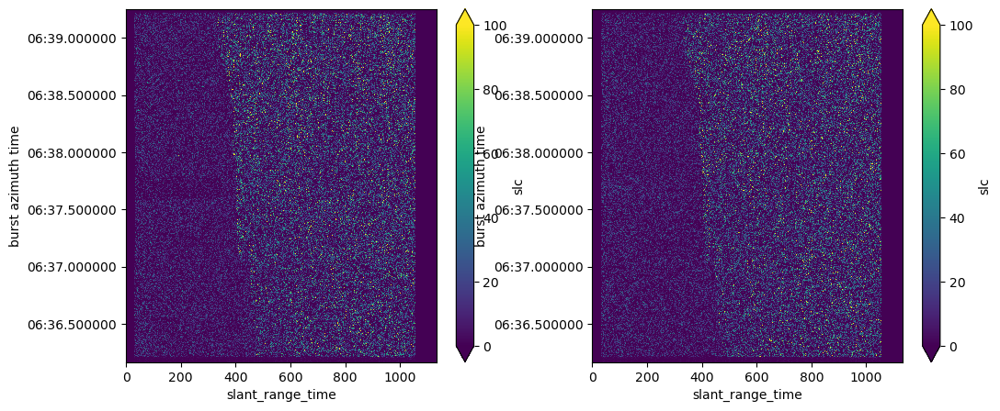

In [10]:
%%time
fig, ax = plt.subplots(1, 2, figsize=(12, 5))
ds.slc[::2, ::20].real.plot(ax=ax[0], vmax=100, vmin=0)
ds.slc[::2, ::20].imag.plot(ax=ax[1], vmax=100, vmin=0)

--- 
## Sentinel-1 OCN

### Ocean Wind Fields (OWI)

In [11]:
%%time
path = (
    "https://objectstore.eodc.eu:2222/e05ab01a9d56408d82ac32d69a5aae2a:sample-data/tutorial_data/"
    "cpm_v253/S1A_IW_OCN__2SDV_20250224T054940_20250224T055005_058034_072A26_160E.zarr"
)

CPU times: user 2 μs, sys: 1 μs, total: 3 μs
Wall time: 4.77 μs


In [12]:
%%time
dt = xr.open_datatree(path, engine="eopf-zarr")
dt

CPU times: user 33.2 ms, sys: 1.18 ms, total: 34.4 ms
Wall time: 221 ms


<xarray.DataTree>
Group: /
│   Attributes:
│       other_metadata:  {'eopf_category': 'eocontainer', 'history': [{'output': ...
│       stac_discovery:  {'assets': {}, 'bbox': [8.978086, 53.692146, 4.470126, 5...
├── Group: /osw
│   │   Attributes:
│   │       other_metadata:  {'eopf_category': 'eocontainer'}
│   │       stac_discovery:  {'links': ['S01SIWOCN_20250224T054940_0025_A332_160E_072...
│   └── Group: /osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV
│       │   Attributes:
│       │       other_metadata:  {'algorithm_version': 'S-1 OSW rev 1/7', 'azimuth_sampli...
│       │       stac_discovery:  {'assets': {}, 'bbox': [8.978086, 53.692146, 4.470126, 5...
│       ├── Group: /osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/conditions
│       │       Dimensions:                                 (azimuth: 1, range: 1,
│       │                                                    partition: 1, lag: 1, ky: 1,
│       │                                                    kx: 1, wavenumber_binsize: 1,
│       │                                                    angular_binsize: 1)
│       │       Coordinates:
│       │           jx                                      (kx) float32 4B ...
│       │           jy                                      (ky) float32 4B ...
│       │           k                                       (wavenumber_binsize) float32 4B ...
│       │         * kx                                      (kx) float32 4B -999.0
│       │         * ky                                      (ky) float32 4B -999.0
│       │           latitude                                (azimuth, range) float32 4B ...
│       │           longitude                               (azimuth, range) float32 4B ...
│       │           phi                                     (angular_binsize) float32 4B ...
│       │       Dimensions without coordinates: azimuth, range, partition, lag,
│       │                                       wavenumber_binsize, angular_binsize
│       │       Data variables: (12/31)
│       │           ambiguity_factor                        (azimuth, range, partition) float32 4B ...
│       │           auxiliary_wind_direction                (azimuth, range) float32 4B ...
│       │           auxiliary_wind_speed                    (azimuth, range) float32 4B ...
│       │           azimuth_cutoff                          (azimuth, range) float32 4B ...
│       │           azimuth_size                            (azimuth, range) float32 4B ...
│       │           azimuth_size_slc                        (azimuth, range) float32 4B ...
│       │           ...                                      ...
│       │           range_cutoff                            (azimuth, range) float32 4B ...
│       │           range_size_slc                          (azimuth, range) float32 4B ...
│       │           skewness                                (azimuth, range) float32 4B ...
│       │           spectrum_resolution                     (azimuth, range, angular_binsize) float32 4B ...
│       │           wind_direction                          (azimuth, range) float32 4B ...
│       │           wind_speed                              (azimuth, range) float32 4B ...
│       ├── Group: /osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/measurements
│       │       Dimensions:                      (azimuth: 1, range: 1, partition: 1,
│       │                                         wavenumber_binsize: 1, angular_binsize: 1)
│       │       Coordinates:
│       │           k                            (wavenumber_binsize) float32 4B ...
│       │           latitude                     (azimuth, range) float32 4B ...
│       │           longitude                    (azimuth, range) float32 4B ...
│       │           phi                          (angular_binsize) float32 4B ...
│       │       Dimensions without coordinates: azimuth, range, partition, wavenumber_binsize,
│       │                              

In [13]:
dt.groups

('/',
 '/osw',
 '/owi',
 '/rvl',
 '/osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV',
 '/owi/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV',
 '/rvl/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV',
 '/osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/conditions',
 '/osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/measurements',
 '/osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/quality',
 '/owi/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/conditions',
 '/owi/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/measurements',
 '/owi/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/quality',
 '/rvl/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/conditions',
 '/rvl/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/measurements',
 '/rvl/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/quality')

In [14]:
%%time
ds = dt.osw.S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV.measurements
ds

CPU times: user 202 μs, sys: 42 μs, total: 244 μs
Wall time: 248 μs


<xarray.DataTree 'measurements'>
Group: /osw/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/measurements
    Dimensions:                      (azimuth: 1, range: 1, partition: 1,
                                      wavenumber_binsize: 1, angular_binsize: 1)
    Coordinates:
        k                            (wavenumber_binsize) float32 4B ...
        latitude                     (azimuth, range) float32 4B ...
        longitude                    (azimuth, range) float32 4B ...
        phi                          (angular_binsize) float32 4B ...
    Dimensions without coordinates: azimuth, range, partition, wavenumber_binsize,
                                    angular_binsize
    Data variables:
        hs                           (azimuth, range, partition) float32 4B ...
        hs_normalised_variance       (azimuth, range, partition) float32 4B ...
        partitions                   (azimuth, range, angular_binsize, wavenumber_binsize) float32 4B ...
        total_hs                     (azimuth, range) float32 4B ...
        total_hs_standard_deviation  (azimuth, range) float32 4B ...
        wave_age                     (azimuth, range) float32 4B ...
        wave_direction               (azimuth, range, partition) float32 4B ...
        wave_length                  (azimuth, range, partition) float32 4B ...
        wind_sea_hs                  (azimuth, range) float32 4B ...

In [15]:
%%time
ds = dt.owi.S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV.measurements
ds

CPU times: user 154 μs, sys: 32 μs, total: 186 μs
Wall time: 189 μs


<xarray.DataTree 'measurements'>
Group: /owi/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/measurements
    Dimensions:         (azimuth: 166, range: 264)
    Coordinates:
        latitude        (azimuth, range) float32 175kB ...
        longitude       (azimuth, range) float32 175kB ...
    Dimensions without coordinates: azimuth, range
    Data variables:
        wind_direction  (azimuth, range) float32 175kB ...
        wind_speed      (azimuth, range) float32 175kB ...

CPU times: user 27.7 ms, sys: 3.71 ms, total: 31.4 ms
Wall time: 144 ms


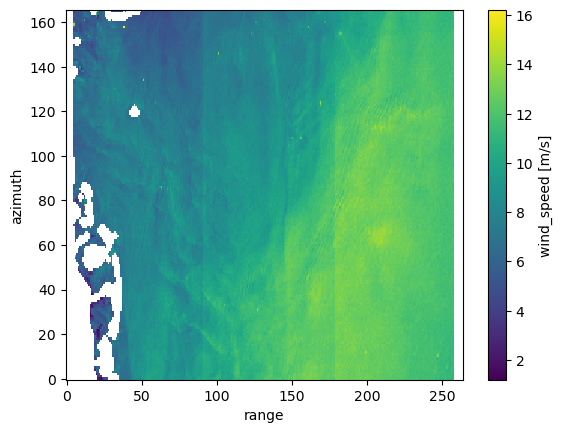

In [16]:
%%time
ds.wind_speed.plot()

In [17]:
%%time
ds = dt.rvl.S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV.measurements
ds

CPU times: user 222 μs, sys: 0 ns, total: 222 μs
Wall time: 224 μs


<xarray.DataTree 'measurements'>
Group: /rvl/S01SIWOCN_20250224T054940_0025_A332_160E_072A26_VV/measurements
    Dimensions:                             (azimuth: 234, range: 135, swath: 3)
    Coordinates:
        latitude                            (azimuth, range, swath) float32 379kB ...
        longitude                           (azimuth, range, swath) float32 379kB ...
    Dimensions without coordinates: azimuth, range, swath
    Data variables:
        radial_velocity                     (azimuth, range, swath) float32 379kB ...
        radial_velocity_standard_deviation  (azimuth, range, swath) float32 379kB ...

CPU times: user 35 ms, sys: 3.57 ms, total: 38.6 ms
Wall time: 249 ms


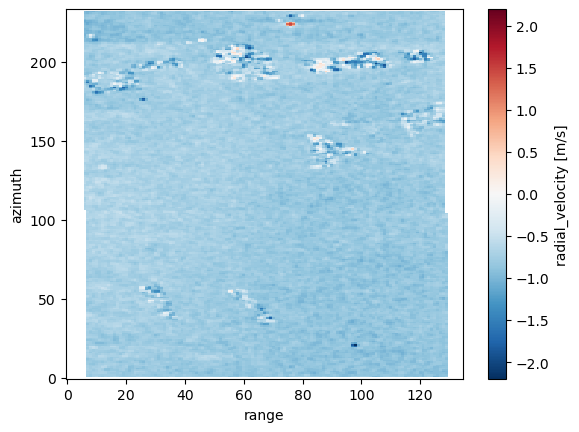

In [18]:
%%time
ds.radial_velocity[:, :, 1].plot()